# What drives the price of a car?

![](images/kurt.jpeg)

**OVERVIEW**

In this application, you will explore a dataset from kaggle. The original dataset contained information on 3 million used cars. The provided dataset contains information on 426K cars to ensure speed of processing.  Your goal is to understand what factors make a car more or less expensive.  As a result of your analysis, you should provide clear recommendations to your client -- a used car dealership -- as to what consumers value in a used car.

### CRISP-DM Framework

<center>
    <img src = images/crisp.png width = 50%/>
</center>


To frame the task, throughout our practical applications we will refer back to a standard process in industry for data projects called CRISP-DM.  This process provides a framework for working through a data problem.  Your first step in this application will be to read through a brief overview of CRISP-DM [here](https://mo-pcco.s3.us-east-1.amazonaws.com/BH-PCMLAI/module_11/readings_starter.zip).  After reading the overview, answer the questions below.

### Business Understanding

From a business perspective, we are tasked with identifying key drivers for used car prices.  In the CRISP-DM overview, we are asked to convert this business framing to a data problem definition.  Using a few sentences, reframe the task as a data task with the appropriate technical vocabulary. 

### Business Objective
- Determine key factors which decides the price of used car
- Provide recommendations to dealership on right pricing that can attrach buyers
- Provide recommendations on car features to lookout which can improve inventory

### Business Sucess Criteria
- Dealership has useful insights about top used car features which can help with inventory 
- Business can use accurate recommendations to adjust business model to attract more sales

### Data Mining Goals
- Identify top features to use for modelling
- Finally create prediction/regression models which can provide accurate results for car pricing

### Data Mining Success Criteria
- Create most accurate model
- Identify key factors which reduce the test prediction error and produces best model

### Data Understanding

After considering the business understanding, we want to get familiar with our data.  Write down some steps that you would take to get to know the dataset and identify any quality issues within.  Take time to get to know the dataset and explore what information it contains and how this could be used to inform your business understanding.

#### Data Exploration Steps:
- Extract the initial used car data with enough features to represent user car value
- Ensure data is clean and formatted to remove nulls, bad values, duplicates etc
- Find the dimensionality of the data
- Define co-relation between features
- Visualize dependent variables

In [ ]:
import numpy as np
import pandas as pd
from IPython.display import display

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.subplots as sp
import plotly.graph_objects as go
import plotly.io as pio
pio.renderers.default='notebook'

from scipy.linalg import svd
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans, DBSCAN
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.compose import make_column_transformer, make_column_selector, ColumnTransformer, TransformedTargetRegressor
from sklearn.feature_selection import SequentialFeatureSelector, SelectFromModel, RFE
from sklearn.preprocessing import StandardScaler, PolynomialFeatures, OneHotEncoder, OrdinalEncoder
from sklearn.linear_model import LinearRegression, Lasso, HuberRegressor, Ridge
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.inspection import permutation_importance
from sklearn.metrics import mean_squared_error
from category_encoders.james_stein import JamesSteinEncoder
from category_encoders.binary import BinaryEncoder
from sklearn.impute import KNNImputer

from sklearn import set_config
set_config(display="diagram")

import warnings
warnings.filterwarnings('ignore')


import statsmodels.api as sm
from statsmodels.datasets import nile
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
import statsmodels.graphics.tsaplots as tsaplots
from statsmodels.tsa.stattools import acf

from statsmodels.tsa.filters.filtertools import convolution_filter
from statsmodels.tsa.seasonal import _extrapolate_trend
from statsmodels.tsa.seasonal import seasonal_decompose, STL
from statsmodels.tsa.forecasting.stl import STLForecast
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa import arima_process
from statsmodels.tsa.stattools import adfuller

In [534]:
## Create dataframe and explore data
cars = pd.read_csv('data/vehicles.csv')
pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', None)
cars.sample(10)

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,state
165676,7313844190,"kansas city, MO",9491,2012.0,mazda,mazda3,NaN,4 cylinders,gas,94034.0,clean,automatic,JM1BL1V7XC1676353,fwd,NaN,sedan,grey,ks
241213,7314342889,raleigh / durham / CH,9900,2012.0,honda,civic si,excellent,4 cylinders,gas,149.0,clean,manual,NaN,fwd,NaN,coupe,red,nc
419871,7315780347,madison,33590,2019.0,ford,ranger supercrew xl pickup,good,NaN,gas,33424.0,clean,other,1FTER4FH3KLA51140,4wd,NaN,pickup,white,wi
312071,7312932559,bend,51938,2020.0,jeep,wrangler,NaN,4 cylinders,gas,24267.0,clean,automatic,1C4HJXEN1LW231259,4wd,NaN,SUV,NaN,or
101133,7312904990,lakeland,35998,2017.0,ford,f-350,NaN,NaN,other,181079.0,clean,automatic,1FT8W3AT5HED16729,fwd,NaN,pickup,silver,fl
240216,7316865836,raleigh / durham / CH,16590,2019.0,hyundai,accent se sedan 4d,good,NaN,gas,39314.0,clean,other,3KPC24A33KE077771,fwd,NaN,sedan,NaN,nc
304180,7302235312,lawton,0,2015.0,chevrolet,silverado 1500,excellent,8 cylinders,gas,86545.0,clean,automatic,3GCUKSEC5FG441749,4wd,mid-size,truck,NaN,ok
177908,7316227663,maine,24695,2012.0,gmc,sierra sle crew cab,NaN,NaN,gas,69000.0,clean,automatic,NaN,NaN,NaN,NaN,NaN,me
261670,7310798404,albuquerque,37590,2017.0,infiniti,qx80 limited sport,good,8 cylinders,gas,60560.0,clean,automatic,JN8AZ2NE9H9151571,4wd,NaN,other,white,nm
230305,7312927616,asheville,23989,2016.0,bmw,x5,NaN,6 cylinders,gas,103176.0,clean,automatic,NaN,4wd,mid-size,SUV,blue,nc


In [535]:
## Check datatypes
cars.info()
# Check percentage null values for all columns sorted by higher to lowest null percentage
for column in cars.isnull().sum().sort_values(ascending=False).index:
    if cars[column].isnull().sum() > 0:
        print(column, ': {:.2%}'.format(cars[column].isnull().sum() /
                                               cars.shape[0]))
# Check Zero values in columns
print ('-----Zero values count across columns-----')
print(cars.eq(0).sum().sort_values(ascending=False))

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426880 entries, 0 to 426879
Data columns (total 18 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   id            426880 non-null  int64  
 1   region        426880 non-null  object 
 2   price         426880 non-null  int64  
 3   year          425675 non-null  float64
 4   manufacturer  409234 non-null  object 
 5   model         421603 non-null  object 
 6   condition     252776 non-null  object 
 7   cylinders     249202 non-null  object 
 8   fuel          423867 non-null  object 
 9   odometer      422480 non-null  float64
 10  title_status  418638 non-null  object 
 11  transmission  424324 non-null  object 
 12  VIN           265838 non-null  object 
 13  drive         296313 non-null  object 
 14  size          120519 non-null  object 
 15  type          334022 non-null  object 
 16  paint_color   296677 non-null  object 
 17  state         426880 non-null  object 
dtypes: f

In [536]:
def stats(df):
    unique_counts = []
    for col in df.columns:
        unique_values = df[col][~df[col].isna() & (df[col] != '') & (df[col] != ' ')].unique()
        unique_counts.append(len(unique_values))
    
    stats_df = pd.DataFrame({'blank_spaces': (df==' ').sum(),
                              'empty_strs': (df=='').sum(),
                              'nulls': df.isnull().sum(), 
                              'null_pct': round(100*(df.isnull().sum()) / len(df),2), 
                              'unique_not_null': df.nunique(),
                              'dups': [df[col].duplicated().sum() for col in df.columns]
                            }).sort_values(by='null_pct', ascending=False)
    return stats_df

stats(cars)

,blank_spaces,empty_strs,nulls,null_pct,unique_not_null,dups
size,0,0,306361,71.77,4,426875
cylinders,0,0,177678,41.62,8,426871
condition,0,0,174104,40.79,6,426873
VIN,0,0,161042,37.73,118246,308633
drive,0,0,130567,30.59,3,426876
paint_color,0,0,130203,30.50,12,426867
type,0,0,92858,21.75,13,426866
manufacturer,0,0,17646,4.13,42,426837
title_status,0,0,8242,1.93,6,426873
model,0,0,5277,1.24,29649,397230


In [537]:
# Check Unique values in all columns
pd.set_option("display.max_colwidth", 90)
print(cars.apply(lambda col: col.unique()))

id              [7222695916, 7218891961, 7221797935, 7222270760, 7210384030, 7222379453, 7221952215, 7...
region          [prescott, fayetteville, florida keys, worcester / central MA, greensboro, hudson vall...
price           [6000, 11900, 21000, 1500, 4900, 1600, 1000, 15995, 5000, 3000, 0, 13995, 24999, 21850...
year            [nan, 2014.0, 2010.0, 2020.0, 2017.0, 2013.0, 2012.0, 2016.0, 2019.0, 2011.0, 1992.0, ...
manufacturer    [nan, gmc, chevrolet, toyota, ford, jeep, nissan, ram, mazda, cadillac, honda, dodge, ...
model           [nan, sierra 1500 crew cab slt, silverado 1500, silverado 1500 crew, tundra double cab...
condition                                            [nan, good, excellent, fair, like new, new, salvage]
cylinders       [nan, 8 cylinders, 6 cylinders, 4 cylinders, 5 cylinders, other, 3 cylinders, 10 cylin...
fuel                                                          [nan, gas, other, diesel, hybrid, electric]
odometer        [nan, 57923.0, 71229.0, 19160.

Text(0.5, 1.0, 'Sum of zero values')

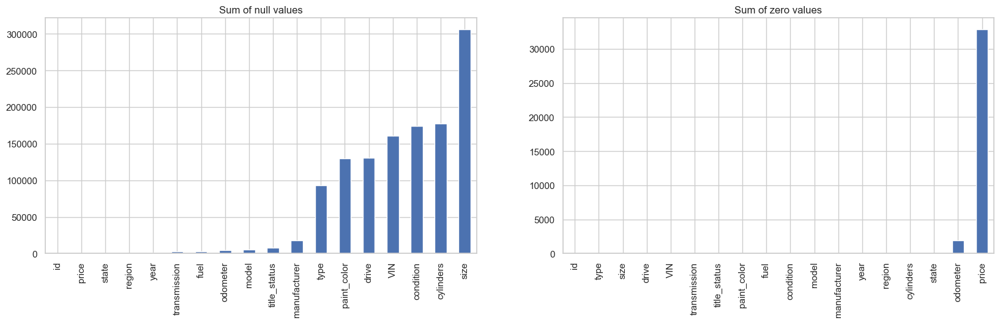

In [531]:
# Visualize null & zero values 
fig, ax = plt.subplots(1, 2, figsize = (20, 5))
cars.isnull().sum().sort_values().plot(kind = 'bar', ax = ax[0]);
ax[0].set_title('Sum of null values')
cars.eq(0).sum().sort_values().plot(kind = 'bar', ax = ax[1])
ax[1].set_title('Sum of zero values')

In [532]:
 cars.describe().apply(lambda y: y.apply(lambda x: format(x, '.0f')))

,id,price,year,odometer
count,426880,426880,425675,422480
mean,7311486634,75199,2011,98043
std,4473170,12182282,9,213882
min,7207408119,0,1900,0
25%,7308143339,5900,2008,37704
50%,7312620821,13950,2013,85548
75%,7315253544,26486,2017,133542
max,7317101084,3736928711,2022,10000000


#### Preliminary information about the dataset size and data types 
- There are 426880 rows and 18 columns
- Out of the features 14 are string & 4 integer
- We have many null values across columns with size, cylinders, condition, VIN, drive, paint_color & type have significant values as null
- Year is a float.  We will convert this to integer
- VIN & Id is a unique value for each car and can therefore be dropped
- Price & Odometer columns have few values as 0

#### Describe the features
 - id: Unique ID for car
 - region: Area car is parked
 - price:  Price of the vehicle
 - year: Manufacturing Year
 - manufacturer: Manufacturing Company
 - model: Car model
 - condition: Car condition
 - cylinders: Number of cylinders in the car
 - fuel: Type of fuel the car consumes
 - odometer: mileage reading from the odometer
 - title_status: Is the title clean - or are there any legal issues with it?
 - transmission: transmission type
 - VIN: Vehicle Identification Number
 - drive: Drivetrain type
 - size: Car body size 
 - type: vehicle form factor
 - paint_color:  Paint Color
 - state: state where vehicle is located

### Data Preparation

After our initial exploration and fine tuning of the business understanding, it is time to construct our final dataset prior to modeling.  Here, we want to make sure to handle any integrity issues and cleaning, the engineering of new features, any transformations that we believe should happen (scaling, logarithms, normalization, etc.), and general preparation for modeling with `sklearn`. 

### Step 1: Check data-types

In [538]:
# Check type of data
cars.dtypes.value_counts()

object     14
int64       2
float64     2
dtype: int64

In [539]:
# Convert categorial columns to right datatype
cars = cars.convert_dtypes()
cars.dtypes.value_counts()

string    14
Int64      4
dtype: int64

### Step 2: Drop unwanted features which are not useful

In [540]:
# Drop unwanted columns
cars_cleaned = cars.drop(columns=['id', 'VIN', 'region', 'state', 'size'])
cars_cleaned.shape

(426880, 13)

In [541]:
cars_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426880 entries, 0 to 426879
Data columns (total 13 columns):
 #   Column        Non-Null Count   Dtype 
---  ------        --------------   ----- 
 0   price         426880 non-null  Int64 
 1   year          425675 non-null  Int64 
 2   manufacturer  409234 non-null  string
 3   model         421603 non-null  string
 4   condition     252776 non-null  string
 5   cylinders     249202 non-null  string
 6   fuel          423867 non-null  string
 7   odometer      422480 non-null  Int64 
 8   title_status  418638 non-null  string
 9   transmission  424324 non-null  string
 10  drive         296313 non-null  string
 11  type          334022 non-null  string
 12  paint_color   296677 non-null  string
dtypes: Int64(3), string(10)
memory usage: 43.6 MB


In [542]:
## Drop null values from columns with null values which cannot be fixed
null_rows_to_drop = ['year','title_status','odometer','transmission','model','fuel','manufacturer']
cars_cleaned = cars_cleaned.dropna(subset=null_rows_to_drop, how='any')
display(stats(cars_cleaned))
cars_cleaned.shape

,blank_spaces,empty_strs,nulls,null_pct,unique_not_null,dups
cylinders,0,0,161353,41.41,8,389595
condition,0,0,157282,40.37,6,389597
drive,0,0,115076,29.54,3,389600
paint_color,0,0,112494,28.87,12,389591
type,0,0,82628,21.21,13,389590
price,0,0,0,0.00,14679,374925
year,0,0,0,0.00,107,389497
manufacturer,0,0,0,0.00,41,389563
model,0,0,0,0.00,21860,367744
fuel,0,0,0,0.00,5,389599


(389604, 13)

In [543]:
## Top 50 car price 
cars_cleaned['price'].value_counts().sort_index(ascending=False).head(50)

3736928711    2
3024942282    2
1410065407    1
1234567890    1
1111111111    1
135008900     1
123456789     4
99999999      1
25003000      1
17000000      1
11111111      1
10004000      1
6995495       1
2000000       1
1234567       2
1111111       4
1000000       3
999999        1
990000        1
777777        2
655000        1
566567        1
425000        1
349999        1
347999        1
304995        3
290000        1
289995        1
289900        1
255000        1
239995        2
239900        2
229500        3
227995        1
225995        1
225000        2
223950        1
215000        1
213000        2
209995        1
204999        3
199999        3
195000        2
185886        1
182000        1
180000        1
179999        2
179995        1
179888        1
175000        2
Name: price, dtype: Int64

In [544]:
## Bottom 50 car price 
cars_cleaned['price'].value_counts().sort_index(ascending=False).tail(50)

59        2
58        4
57        1
56        1
55        3
54        1
53        3
51        1
50        9
48        3
45        4
44        2
42        2
40        1
39        1
36        1
35        5
34        1
33        3
32        2
30        7
29        3
28        2
27        2
25        8
24        1
23        6
22        3
21        3
20        6
19        5
18        3
17        9
16        6
15       15
14        9
13        6
12        8
11        9
10       21
9        10
8         5
7         6
6        11
5        11
4         4
3         9
2        12
1      1637
0     28576
Name: price, dtype: Int64

In [545]:
## Vizualize the car prices 
fig = px.box(cars_cleaned, x = 'price')
fig.update_layout(
    title="Car Price Distribution",
    xaxis_title="Car Prices"
)
fig.show('notebook')

In [524]:
cars_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 331067 entries, 27 to 426879
Data columns (total 13 columns):
 #   Column        Non-Null Count   Dtype 
---  ------        --------------   ----- 
 0   price         331067 non-null  Int64 
 1   year          331067 non-null  Int64 
 2   manufacturer  331067 non-null  string
 3   model         331067 non-null  string
 4   condition     205343 non-null  string
 5   cylinders     195514 non-null  string
 6   fuel          331067 non-null  string
 7   odometer      331067 non-null  Int64 
 8   title_status  331067 non-null  string
 9   transmission  331067 non-null  string
 10  drive         233283 non-null  string
 11  type          264064 non-null  string
 12  paint_color   239395 non-null  string
dtypes: Int64(3), string(10)
memory usage: 36.3 MB


In [546]:
print(cars_cleaned.price.count())
print(cars_cleaned.query('price < 400_000', engine='python').price.count())
print(cars_cleaned.query('price > 100', engine='python').price.count())

389604
389569
358008


In [547]:
## There is wide variation with outliers in Price data, we need to remove outliers
cars_cleaned = cars_cleaned.query('price < 400_000', engine='python')
cars_cleaned = cars_cleaned.query('price > 100', engine='python')
cars_cleaned.shape

(357973, 13)

In [526]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

In [548]:
fig = make_subplots(rows=1, cols=2, subplot_titles=('Cars prices below 50k',  'Cars prices above 50k'))

fig.add_trace(
    go.Histogram(x=cars_cleaned["price"],xbins=dict(
                      start='0',
                      end='50000'), # M18 stands for 18 months
                      autobinx=False, name="Count Cars")
                   ,row=1, col=1
)


fig.add_trace(
    go.Histogram(x=cars_cleaned["price"],xbins=dict(
                      start='50000',
                      end='400000'), # M18 stands for 18 months
                      autobinx=False, name="Count Cars"),
    row=1, col=2
)

fig.update_layout(height=600, width=1000, title_text="Car Price Counts")
fig.show()

In [549]:
fig = px.histogram(cars_cleaned,x="price",title="Histogram of Car Prices",
                    labels={"price": "Price"},barmode='group',color_discrete_sequence = px.colors.qualitative.Dark24,
                   range_x=(0,20000), nbins = 2000)
fig.show()

In [550]:
## Vizualize the Car year 
fig = px.box(cars_cleaned, x = 'year')
fig.update_layout(
    title="Distribution of Years Manufactured",
    xaxis_title="Year Manufactured"
)
fig.update_layout(height=600, width=1000, title_text="Car Year Distribution")
fig.show()

In [551]:
year_hist = px.histogram(cars_cleaned,x="year",title="Histogram of Year of Manufacture",
                    labels={"year": "Year"}, nbins=500 
                         )
year_hist.show()

In [552]:
print(cars_cleaned.year.count())
print(cars_cleaned.query('price < 1995', engine='python').year.count())
print(cars_cleaned.query('price >= 1995', engine='python').year.count())

357973
13264
344709


In [553]:
## Based on above plots we see year data has outliers before 1995 hence we will delete all year data < 1995

#eliminate extreme outliers that would throw off the IQR calculation
cars_cleaned = cars_cleaned.query('year >= 1995', engine='python')
cars_cleaned.shape

(346325, 13)

In [ ]:
## Save the cars cleaned data to CSV
cars_cleaned.to_csv('data/cars_cleaned_1.csv', encoding = 'utf-8-sig')

In [554]:
## Vizualize Odometer data
fig = px.box(cars_cleaned, x = 'odometer')
fig.update_layout(
    title="Odometer Reading Distribution",
    xaxis_title="Odometer Readings"
)
fig.show('notebook')

In [555]:
odo_hist = px.histogram(cars_cleaned,x="odometer",title="Histogram of Odomoter Readings",
                    labels={"odomter": "Odometer Reading"},color_discrete_sequence = px.colors.qualitative.Dark24,
                   range_x=(0,400_000), nbins=10_000
                         )
odo_hist.show()

In [556]:
## Cleanup Odometer data to remove outliers for very low Odometer reading
cars_cleaned = cars_cleaned.query('odometer >= 1000', engine='python')
cars_cleaned.shape

(340994, 13)

In [ ]:
## Create function to remove any remaining outliers using IQR calculation
def eliminate_outliers(df, column_name):
    """
    Removes outliers from a specific column in a dataframe using the IQR method.
    
    Parameters:
    - df (pd.DataFrame): The input dataframe.
    - column_name (str): The column from which outliers should be removed.
    
    Returns:
    - pd.DataFrame: A dataframe with outliers removed from the specified column.
    """
    Q1 = df[column_name].quantile(0.25)
    Q3 = df[column_name].quantile(0.75)
    IQR = Q3 - Q1

    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    
    print(f'lower_bound: {lower_bound} and upper_bound: {upper_bound}')
    df_cleaned = df.query(f"{lower_bound} <= {column_name} <= {upper_bound}", engine='python') 
    #df_cleaned = df[(df[column_name] >= lower_bound) & (df[column_name] <= upper_bound)]
    print(f'Removed {len(df)- len(df_cleaned)} rows')
    
    
    return df_cleaned


In [557]:
cars_cleaned = eliminate_outliers(cars_cleaned, 'year')
cars_cleaned.shape

lower_bound: 1997.0 and upper_bound: 2029.0
Removed 2049 rows


(338945, 13)

In [558]:
cars_cleaned = eliminate_outliers(cars_cleaned, 'odometer')
cars_cleaned.shape

lower_bound: -104005.0 and upper_bound: 280003.0
Removed 2297 rows


(336648, 13)

In [559]:
cars_cleaned = eliminate_outliers(cars_cleaned, 'price')
cars_cleaned.shape

lower_bound: -22110.0 and upper_bound: 58050.0
Removed 5648 rows


(331000, 13)

### Step 3:Impute missing values for other features that can be fixed



Text(0.5, 1.0, 'Sum of zero values')

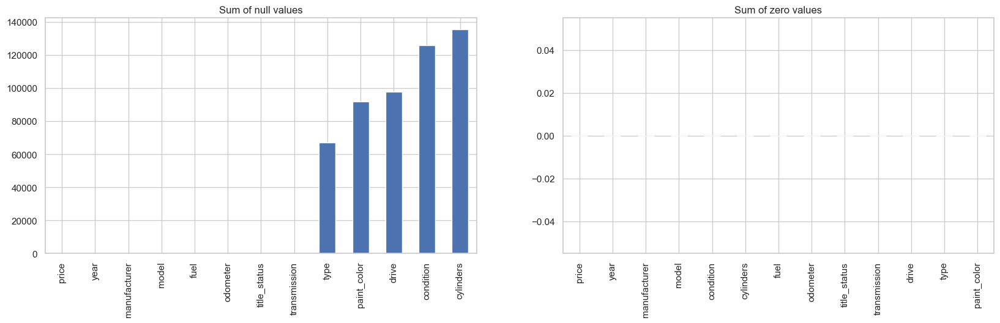

In [560]:
# Visualize null & zero values 
fig, ax = plt.subplots(1, 2, figsize = (20, 5))
cars_cleaned.isnull().sum().sort_values().plot(kind = 'bar', ax = ax[0]);
ax[0].set_title('Sum of null values')
cars_cleaned.eq(0).sum().sort_values().plot(kind = 'bar', ax = ax[1])
ax[1].set_title('Sum of zero values')

In [ ]:
## Impute missing price values using KNNImputer

### Create a copy of dataframe

cars_impute = cars_cleaned.copy()

### Start with cylinder column imputation
cars_impute['cylinders'] = cars_impute['cylinders'].fillna('np.nan')
cyl_order = [np.nan, 'other', '3 cylinders', '4 cylinders', '5 cylinders', '6 cylinders', '8 cylinders', '10 cylinders', '12 cylinders']
cyl_mapping = {value: index for index, value in enumerate(cyl_order)}
cars_impute['cylinders_labenc'] = cars_cleaned['cylinders'].map(cyl_mapping)
cars_impute.drop(['cylinders'], axis=1, inplace=True)

In [ ]:
cars_impute.cylinders_labenc.unique()

In [ ]:
#Initialize KNN imputer with default metric=’nan_euclidean’
col_to_imp = ['cylinders_labenc']
knn_imputer = KNNImputer(n_neighbors=2)
imputed_val_cyl = knn_imputer.fit_transform(cars_impute[col_to_imp])

In [ ]:
## Fill the missing nan values with imputed predictions
cars_impute['cylinders_labenc'] = imputed_val_cyl
print(cars_impute['cylinders_labenc'].eq(0).sum())

In [ ]:
cars_impute.cylinders_labenc.unique()

In [ ]:
## Convert the decimal value for cylinder to nearest whole number
cars_impute['cylinders_labenc'] = cars_impute['cylinders_labenc'].apply(np.ceil)
cars_impute.cylinders_labenc.unique()

In [ ]:
print(cars_impute.condition.unique())
print(cars_impute[cars_impute.condition.isna()]['odometer'].value_counts())


In [ ]:
### Condition column imputation
cars_impute['condition'] = cars_impute['condition'].fillna('np.nan')
condition_order = [np.nan, 'salvage', 'fair', 'good', 'excellent', 'like new', 'new']
condition_mapping = {value: index for index, value in enumerate(condition_order)}
cars_impute['condition_labenc'] = cars_cleaned['condition'].map(condition_mapping)
cars_impute.drop(['condition'], axis=1, inplace=True)

In [ ]:
print(cars_impute.condition_labenc.unique())

In [ ]:
#Initialize KNN imputer with default metric=’nan_euclidean’
col_to_imp = ['condition_labenc']
knn_imputer = KNNImputer(n_neighbors=2)
imputed_val_cond = knn_imputer.fit_transform(cars_impute[col_to_imp])

In [ ]:
## Fill the missing nan values with imputed predictions
cars_impute['condition_labenc'] = imputed_val_cond
print(cars_impute['condition_labenc'].eq(0).sum())

In [ ]:
## Save the cars cleaned data to CSV
cars_impute.to_csv('data/cars_imputed_1.csv', encoding = 'utf-8-sig')

In [ ]:
print(cars_impute.drive.unique())

In [ ]:
### drive column imputation
cars_impute['drive'] = cars_impute['drive'].fillna('np.nan')
drive_order = [np.nan, 'fwd','rwd','4wd']
drive_mapping = {value: index for index, value in enumerate(drive_order)}
cars_impute['drive_labenc'] = cars_cleaned['drive'].map(drive_mapping)
cars_impute.drop(['drive'], axis=1, inplace=True)

In [ ]:
#Initialize KNN imputer with default metric=’nan_euclidean’
col_to_imp = ['drive_labenc']
knn_imputer = KNNImputer(n_neighbors=2)
imputed_val_drive = knn_imputer.fit_transform(cars_impute[col_to_imp])

In [ ]:
## Fill the missing nan values with imputed predictions
cars_impute['drive_labenc'] = imputed_val_drive
print(cars_impute['drive_labenc'].eq(0).sum())

In [ ]:
## Save the cars imputed data to CSV
cars_impute.to_csv('data/cars_imputed_2.csv', encoding = 'utf-8-sig')

In [ ]:
## Check missing values in paint_color
print(cars_impute.paint_color.isna().sum())
print(cars_impute.type.isna().sum())

In [ ]:
cars_impute.info()

In [ ]:
## Create dataframe copy to check paint_color and type 
cars_paint_color = cars.copy()

In [ ]:
cars_paint_color.paint_color.isna().sum()

In [ ]:
cars_paint_color.info()

In [ ]:
cars_paint_na_vins = cars_paint_color.query('paint_color.isnull() & VIN.notna()', engine='python')['VIN'].unique()

In [ ]:
cars_paint_with_vins = cars_paint_color.query('paint_color.notna() & VIN in @cars_paint_na_vins')[['VIN','paint_color']]

In [ ]:
cars_paint_color_merged = cars_paint_color.merge(cars_paint_with_vins,on='VIN',how="left")

In [ ]:
cars_paint_color_merged.paint_color_x.isna().sum()
#cars_paint_color_merged.paint_color_y.isna().sum()

In [ ]:
cars_paint_color_merged['paint_color_x'] = cars_paint_color_merged['paint_color_x'].fillna(cars_paint_color_merged['paint_color_y'])
cars_paint_color_merged.drop(["paint_color_y"],inplace=True,axis=1)
cars_paint_color_merged.rename(columns={'paint_color_x':'paint_color'},inplace=True)

In [ ]:
cars_paint_color_merged.paint_color.isna().sum()

In [ ]:
#this is the number of duplicates that will be dropped
cars_paint_color_merged[cars_paint_color_merged.duplicated()].shape[0]

In [ ]:
cars_type_na_vins = cars_paint_color.query('type.isnull() & VIN.notna()', engine='python')['VIN'].unique()
cars_type_with_vins = cars_paint_color.query('type.notna() & VIN in @cars_type_na_vins')[['VIN','type']]

In [ ]:
cars_paint_type_merged = cars_paint_color.merge(cars_type_with_vins,on='VIN',how="left")

In [ ]:
cars_paint_type_merged.info()

In [ ]:
cars_paint_type_merged['type_x'] = cars_paint_type_merged['type_x'].fillna(cars_paint_type_merged['type_y'])
cars_paint_type_merged.drop(["type_y"],inplace=True,axis=1)
cars_paint_type_merged.rename(columns={'type_x':'type'},inplace=True)

In [ ]:
cars_paint_type_merged.type.isna().sum()

In [ ]:
## Drop null values from columns with null values which cannot be fixed
null_rows_to_drop = ['year','title_status','odometer','transmission','model','fuel','manufacturer']
cars_paint_type_merged = cars_paint_type_merged.dropna(subset=null_rows_to_drop, how='any')
cars_paint_type_merged.shape

In [ ]:
cars_paint_type_merged = cars_paint_type_merged.query('price < 400_000', engine='python')
cars_paint_type_merged = cars_paint_type_merged.query('price > 100', engine='python')


cars_paint_type_merged = cars_paint_type_merged.query('year >= 1995', engine='python')


cars_paint_type_merged = cars_paint_type_merged.query('odometer >= 1000', engine='python')


cars_paint_type_merged = eliminate_outliers(cars_paint_type_merged, 'year')


cars_paint_type_merged = eliminate_outliers(cars_paint_type_merged, 'odometer')


cars_paint_type_merged = eliminate_outliers(cars_paint_type_merged, 'price')


In [ ]:
print(cars_paint_type_merged.shape)
print(cars_impute.shape)

In [ ]:
cars_paint_type_merged[cars_paint_type_merged.duplicated()].shape[0]

In [ ]:
#drop duplicates
cars_paint_type_merged.drop_duplicates(inplace=True)
cars_paint_type_merged.shape[0]


In [ ]:
# Drop unwanted columns
cars_paint_type_merged = cars_paint_type_merged.drop(columns=['id', 'VIN', 'region', 'state', 'size'])
cars_paint_type_merged.shape

In [ ]:
cars_paint_type_merged[cars_paint_type_merged.duplicated()].shape[0]

In [ ]:
#drop duplicates
cars_paint_type_merged.drop_duplicates(inplace=True)
cars_paint_type_merged.shape[0]

In [ ]:
## Save the cars paint & type imputed data to CSV
cars_paint_type_merged.to_csv('data/cars_paint_type_imputed.csv', encoding = 'utf-8-sig')

In [ ]:
#drop duplicates
cars_paint_type_merged.drop_duplicates(inplace=True)
print(cars_paint_type_merged.shape[0])

cars_impute.drop_duplicates(inplace=True)
print(cars_impute.shape[0])


In [ ]:
cars_impute.info()

In [355]:
## Merge the two dataframes
cars_impute_merge = cars_impute.merge(cars_paint_type_merged,on=['year','manufacturer','model','odometer','fuel','type','transmission','price','title_status','paint_color'], how='left')



In [363]:
## Drop unwanted columns that we already encoded
cars_impute_merge = cars_impute_merge.drop(columns=['condition', 'cylinders', 'drive'])



In [364]:
cars_impute_merge.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 190960 entries, 0 to 190959
Data columns (total 13 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   price             190960 non-null  Int64  
 1   year              190960 non-null  Int64  
 2   manufacturer      190960 non-null  string 
 3   model             190960 non-null  string 
 4   fuel              190960 non-null  string 
 5   odometer          190960 non-null  Int64  
 6   title_status      190960 non-null  string 
 7   transmission      190960 non-null  string 
 8   type              145119 non-null  string 
 9   paint_color       138851 non-null  string 
 10  cylinders_labenc  190960 non-null  float64
 11  condition_labenc  190960 non-null  float64
 12  drive_labenc      190960 non-null  float64
dtypes: Int64(3), float64(3), string(7)
memory usage: 20.9 MB


Text(0.5, 1.0, 'Sum of zero values')

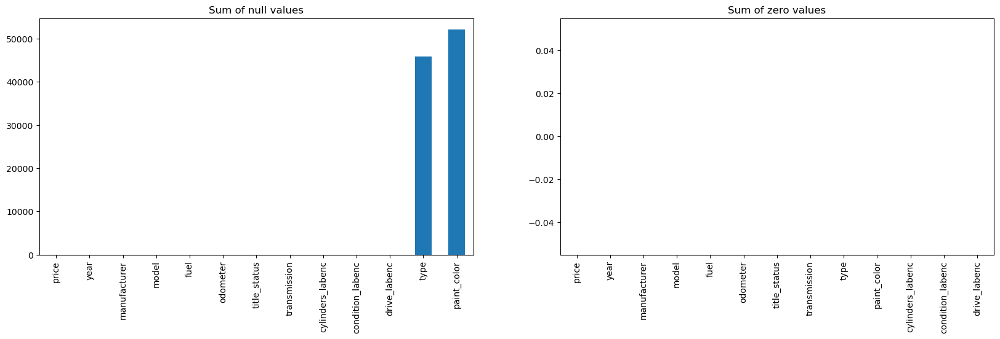

In [366]:
# Visualize null & zero values again
fig, ax = plt.subplots(1, 2, figsize = (20, 5))
cars_impute_merge.isnull().sum().sort_values().plot(kind = 'bar', ax = ax[0]);
ax[0].set_title('Sum of null values')
cars_impute_merge.eq(0).sum().sort_values().plot(kind = 'bar', ax = ax[1])
ax[1].set_title('Sum of zero values')


In [378]:
cars_impute_merge.query('type.isna()')['model'].value_counts(ascending=False)

f-150                    857
silverado 1500           585
camry                    521
accord                   507
1500                     484
                        ... 
tracker zr2 4x4            1
avenger r/t 4dr sedan      1
pathfinder 4x4             1
durango sxt awd            1
1500 z71                   1
Name: model, Length: 6099, dtype: Int64

In [379]:
cars_impute_merge.query('model == "f-150" & type.notna()')

,price,year,manufacturer,model,fuel,odometer,title_status,transmission,type,paint_color,cylinders_labenc,condition_labenc,drive_labenc
236,8950,2011,ford,f-150,gas,164000,clean,automatic,truck,white,5.0,4.000000,1.0
489,29900,2019,ford,f-150,gas,23004,clean,automatic,truck,white,6.0,5.000000,2.0
513,16700,2013,ford,f-150,gas,180917,clean,other,truck,<NA>,6.0,3.528574,3.0
585,2595,2003,ford,f-150,gas,149055,clean,automatic,pickup,red,6.0,4.000000,3.0
669,32500,2019,ford,f-150,gas,7700,clean,automatic,truck,grey,5.0,5.000000,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
190857,8000,2002,ford,f-150,gas,139500,clean,automatic,truck,white,6.0,5.000000,3.0
190865,25467,2015,ford,f-150,other,122987,clean,automatic,pickup,white,5.0,3.528574,3.0
190866,32499,2018,ford,f-150,other,80079,clean,automatic,pickup,<NA>,5.0,3.528574,3.0
190867,31755,2017,ford,f-150,other,76757,clean,automatic,pickup,white,5.0,3.528574,3.0


In [ ]:
cars_impute_merge.sort_values(by=['model','',inplace=True)

In [380]:
## Use ffile to attempt and fill missing type values from same car model having the type value in other row
cars_impute_merge['type'] = cars_impute_merge.groupby('model')['type'].transform(lambda x: x.fillna(method='ffill').fillna(method='bfill'))



In [389]:
cars_impute_merge.query('model == "f-150" & type.notna()').sample(10)

,price,year,manufacturer,model,fuel,odometer,title_status,transmission,type,paint_color,cylinders_labenc,condition_labenc,drive_labenc
95439,7900,2007,ford,f-150,gas,134702,clean,automatic,pickup,<NA>,5.0,3.528574,2.060617
184752,4200,1999,ford,f-150,gas,148000,clean,manual,pickup,white,5.0,4.000000,2.000000
19007,1000,2007,ford,f-150,gas,200000,clean,automatic,truck,brown,5.0,3.000000,2.000000
173669,36000,2017,ford,f-150,gas,60500,clean,automatic,truck,grey,5.0,4.000000,3.000000
165960,3500,2011,ford,f-150,gas,210826,salvage,automatic,pickup,<NA>,5.0,3.528574,2.060617
167919,22500,2016,ford,f-150,gas,93314,clean,automatic,pickup,white,5.0,3.000000,1.000000
49092,12499,2012,ford,f-150,gas,190000,clean,automatic,truck,silver,6.0,4.000000,3.000000
139924,50700,2020,ford,f-150,gas,2942,clean,automatic,truck,grey,5.0,4.000000,3.000000
108836,19488,2013,ford,f-150,gas,150747,clean,other,truck,black,5.0,3.528574,3.000000
174068,19981,2012,ford,f-150,gas,156087,clean,automatic,pickup,silver,5.0,3.528574,3.000000


In [386]:
cars_impute_merge.query('type.isna()')['model'].count()

2643

In [391]:
## lets use same technique to ffill the missing paint_color for same car model and same year to avoid skewing the data
cars_impute_merge['paint_color'] = cars_impute_merge.groupby(['model','year'])['paint_color'].transform(lambda x: x.fillna(method='ffill').fillna(method='bfill'))


In [393]:
print(cars_impute_merge.type.isna().sum())
print(cars_impute_merge.paint_color.isna().sum())

2643
8556


In [394]:
## Since most type values are filled we can delete the small null values which cannot be fixed
null_rows_to_drop = ['type','paint_color']
cars_impute_merge = cars_impute_merge.dropna(subset=null_rows_to_drop, how='any')
cars_impute_merge.shape

(181672, 13)

In [395]:
## Save the cars paint & type imputed data to CSV
cars_impute_merge.to_csv('data/cars_final_imputed_cleaned.csv', encoding = 'utf-8-sig')

Text(0.5, 1.0, 'Sum of zero values')

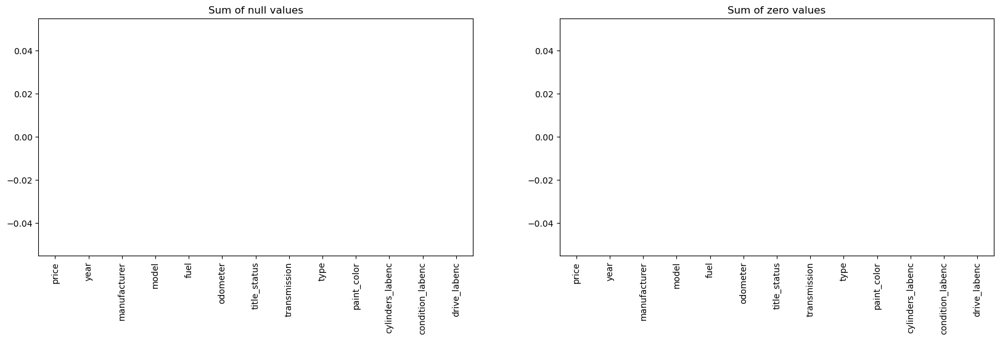

In [396]:
# Visualize null & zero values final time
fig, ax = plt.subplots(1, 2, figsize = (20, 5))
cars_impute_merge.isnull().sum().sort_values().plot(kind = 'bar', ax = ax[0]);
ax[0].set_title('Sum of null values')
cars_impute_merge.eq(0).sum().sort_values().plot(kind = 'bar', ax = ax[1])
ax[1].set_title('Sum of zero values')

#### Update price to logarithm
We observe that if we take the logarithm of the price, instead of the price, we get a more normal distribution.  Based on this we will use the log of price in our modeling

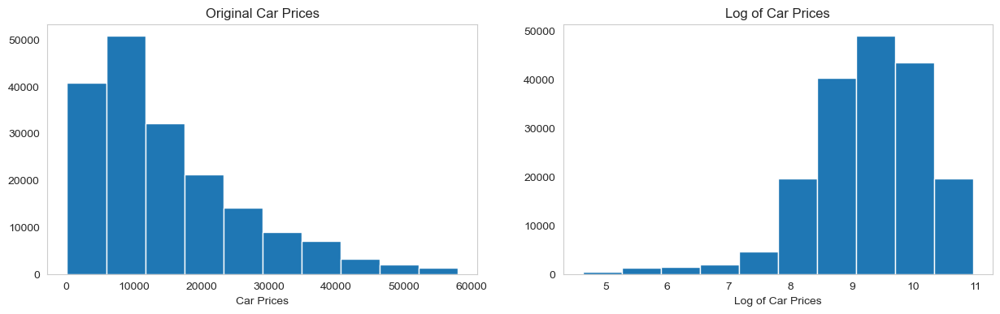

In [399]:
#plot result column and log of result column 

plt.figure(figsize=(15, 4))  # Adjust size to accommodate two subplots
sns.set_style('whitegrid')

# First subplot
plt.subplot(1, 2, 1)  # 1 row, 2 columns, subplot 1
plt.hist(cars_impute_merge['price'])
plt.xlabel('Car Prices')
plt.title('Original Car Prices')
plt.grid()

plt.subplot(1, 2, 2)  # 1 row, 2 columns, subplot 2
plt.hist(b(cars_impute_merge['price']))
plt.xlabel('Log of Car Prices')
plt.title('Log of Car Prices')
plt.grid()

### Visualisations the data relationships

price               1.000000
year                0.601264
drive_labenc        0.290792
cylinders_labenc    0.224077
condition_labenc    0.115284
odometer           -0.551018
Name: price, dtype: float64

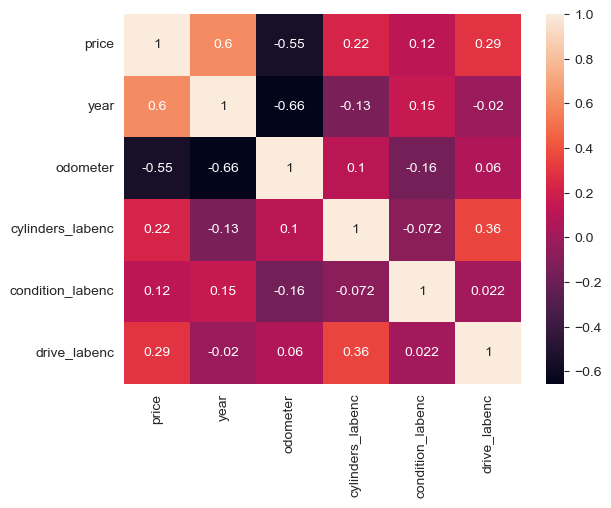

In [401]:
## Check co-relation matrix 

correlation_matrix = cars_impute_merge.corr(numeric_only=True)

# Extract correlations with the price column
price_correlation = correlation_matrix['price'].sort_values(ascending=False)

sns.heatmap(correlation_matrix, annot=True)
display(price_correlation)

#### Co-relation heatmap Observations
- Highest positive correlations with price are:
    - year (+0.60)
    - drive_labenc (+0.29)
    - cylinders_labenc (+0.22)
    
- Highest negative correlations with price are:    
    - odometer (-0.55)
    
- Condition is are weakly correated with price (+0.11)

- We also note a high -ve correlation between year and odometer (-0.66) which makes sense

<Axes: xlabel='price', ylabel='cylinders_labenc'>

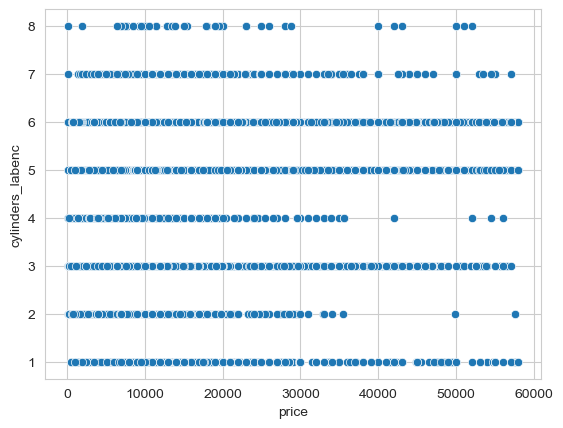

In [406]:
fig = sns.scatterplot(cars_impute_merge, x = "price", y = "cylinders_labenc")
fig

In [416]:
cars_impute_merge.cylinders_labenc = cars_impute_merge.cylinders_labenc.astype(int)


cars_impute_merge.cylinders_labenc.unique()

array([6, 5, 3, 4, 7, 1, 2, 8])

In [414]:
cars_impute_merge.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 181672 entries, 0 to 190959
Data columns (total 13 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   price             181672 non-null  Int64  
 1   year              181672 non-null  Int64  
 2   manufacturer      181672 non-null  string 
 3   model             181672 non-null  string 
 4   fuel              181672 non-null  string 
 5   odometer          181672 non-null  Int64  
 6   title_status      181672 non-null  string 
 7   transmission      181672 non-null  string 
 8   type              181672 non-null  string 
 9   paint_color       181672 non-null  string 
 10  cylinders_labenc  181672 non-null  int64  
 11  condition_labenc  181672 non-null  float64
 12  drive_labenc      181672 non-null  float64
dtypes: Int64(3), float64(2), int64(1), string(7)
memory usage: 19.9 MB


Text(29.965917695473273, 0.5, 'Count')

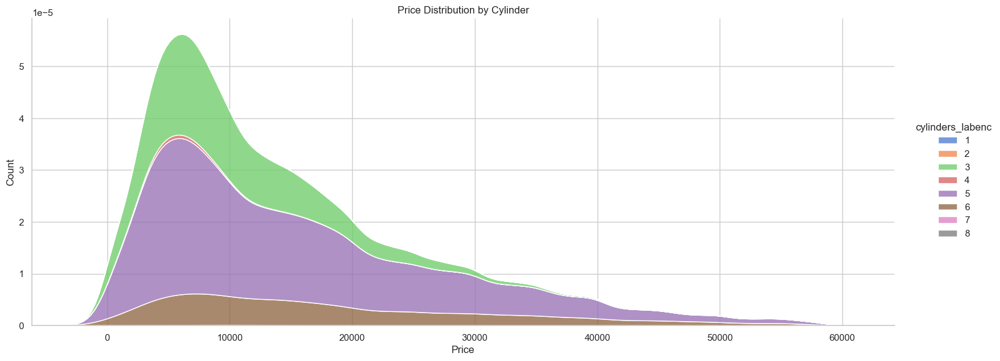

In [439]:
sns.set(style="whitegrid")

sns.displot(data=cars_impute_merge, x=cars_impute_merge["price"].astype(int), hue="cylinders_labenc", kind='kde', multiple = "stack", height = 6, aspect = 2.5, palette = 'muted') 
plt.title('Price Distribution by Cylinder')
plt.xlabel('Price')
plt.ylabel('Count')

Text(32.318148148148175, 0.5, 'Count')

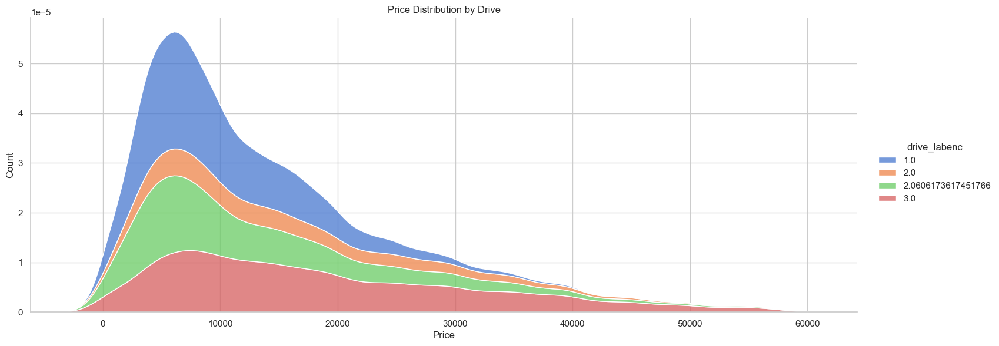

In [438]:
sns.set(style="whitegrid")

sns.displot(data=cars_impute_merge, x=cars_impute_merge["price"].astype(int), hue="drive_labenc",kind='kde', multiple = "stack", height = 6, aspect = 2.5, palette = 'muted') 
plt.title('Price Distribution by Drive')
plt.xlabel('Price')
plt.ylabel('Count')

Text(16.058740740740767, 0.5, 'Count')

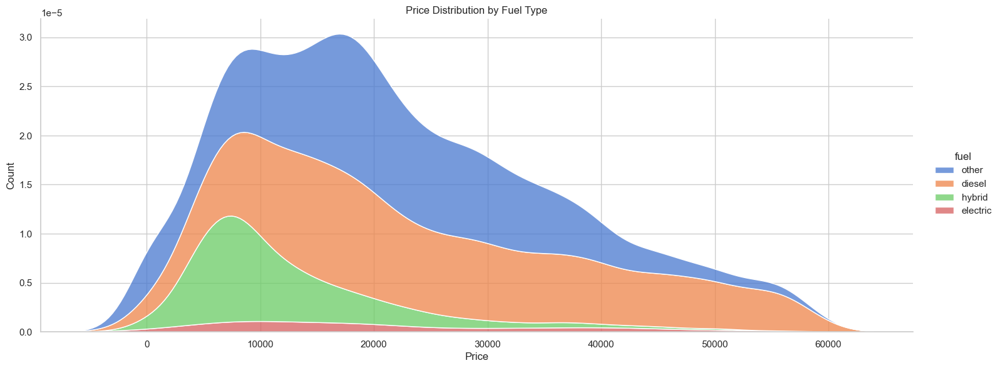

In [437]:
sns.set(style="whitegrid")

#Note: removed gas since there are gas cars at all prices and it dwarfs the other fuel types
sns.displot(data=cars_impute_merge[cars_impute_merge['fuel'] != 'gas'], x=cars_impute_merge["price"].astype(int), hue="fuel", kind='kde', multiple = "stack", height = 6, aspect = 2.5, palette = 'muted') 
plt.title('Price Distribution by Fuel Type')
plt.xlabel('Price')
plt.ylabel('Count')
#plt.legend(title='Cylinders', labels=['Yes', 'No'], bbox_to_anchor=(1.05, 1), loc='upper left')

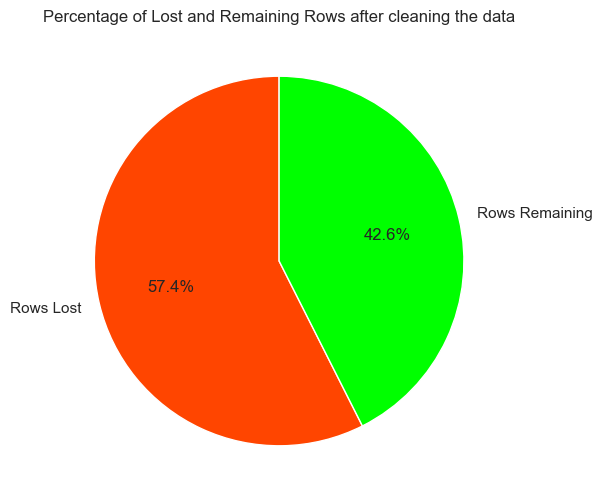

In [564]:
# Number of rows in the original and prepared datasets
total_rows_initial = cars.shape[0]
total_rows_prepared = cars_impute_merge.shape[0]

# Calculate the number of rows lost and remaining
rows_lost = total_rows_initial - total_rows_prepared
rows_remaining = total_rows_prepared

# Labels for the pie chart
labels = ['Rows Lost', 'Rows Remaining']

# Values for the pie chart
values = [rows_lost, rows_remaining]

# Create the pie chart
plt.figure(figsize=(6, 6))
plt.pie(values, labels=labels, autopct='%1.1f%%', startangle=90, colors=['orangered', 'lime'])
plt.title('Percentage of Lost and Remaining Rows after cleaning the data')
plt.show()

### Modeling

With your (almost?) final dataset in hand, it is now time to build some models.  Here, you should build a number of different regression models with the price as the target.  In building your models, you should explore different parameters and be sure to cross-validate your findings.

In [444]:
#Helper function to get number of possible values in each column
def get_feature_category_counts(df):
    feature_category_dict = {col: len(df[col].unique()) for col in df.columns if df[col].dtype not in ['int64', 'float64', 'Int64']}
    return pd.DataFrame(list(feature_category_dict.items()), columns=['Feature', 'Number_of_Categories'])

In [445]:
feature_category_counts = get_feature_category_counts(cars_impute_merge)
feature_category_counts

,Feature,Number_of_Categories
0,manufacturer,39
1,model,13835
2,fuel,5
3,title_status,6
4,transmission,3
5,type,13
6,paint_color,12


### Encoding Strategy for remaining categorical features

1. Due to high cardinality we will try both James Stein and Binary Encoders for: 
- model: 7564 (James Stein or Binary)
- manufacturer: 38 (James Stein or Binary)

2. **OneHotEncoder**
- fuel: 5 (OneHot) 
- title_status: 6 (OneHot)
- transmission: 3 (OneHot)
- type: 13 (OneHot)
- paint_color: 12 (OneHot)

In [446]:
#### Prepare predictor and target data set for models

X = cars_impute_merge.drop(columns='price')
y = cars_impute_merge['price']

random_state=42


In [447]:
## Helper functions to create validation data set & search Hyper parameters

def holdout_validation(X,y,model=LinearRegression(), test_size=0.3, random_state=42):
    #Shuffle and split data
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = test_size ,random_state = random_state)
    #fit
    model.fit(X_train,y_train)
    #predict and calucated train and test MSEs
    train_preds = model.predict(X_train)
    test_preds = model.predict(X_test)
    train_mse = mean_squared_error(y_train, train_preds)
    test_mse = mean_squared_error(y_test, test_preds)
    
    print(f'Train MSE: {train_mse: .2f}')
    print(f'Test MSE: {test_mse: .2f}')
    
    return 
    
def hyperparameter_search(
    X, y,
    transformer=None, 
    selector = None,   
    scaler=None,
    regressor=LinearRegression(),
    ttr=False,
    transformer_params={},  
    selector_params={},
    regressor_params={}, 
    scoring= ["neg_mean_squared_error", "neg_mean_absolute_error", "neg_root_mean_squared_error"],
    kfolds=[5, 10, 20, 50, 100, X.shape[0]], 
    verbose = 0,
    random_state=42
):

    steps = []
    transformer_label, regressor_label = '', ''
    
    #Define default labels for transformers, selector and regressors
    transformer_type_to_label = {
    PolynomialFeatures: 'poly',
    }
    
    #labeling for selector to be improved later
    selector_type_to_label = {
        SequentialFeatureSelector: 'selector',
        RFE: 'selector',
        Lasso: 'selector'
    }
    
    regressor_type_to_label = {
    Lasso: 'lasso',
    Ridge: 'ridge',
    HuberRegressor: 'huber',
    LinearRegression: 'linreg'
    }
    
    #Select labels to be used in pipeline and param grid
    if  transformer_params and transformer is not None:
        transformer_params_full_label = next(iter(transformer_params))
        transformer_label = transformer_params_full_label.split('__')[0]
        steps.append((transformer_label, transformer))
    elif transformer is not None: 
        transformer_label = transformer_type_to_label.get(type(transformer), 'transform')
        steps.append((transformer_label, transformer))
        
    if scaler is not None:
        scaler_label = 'scaler'
        steps.append((scaler_label, scaler))

    if  selector_params and selector is not None:
        selector_params_full_label = next(iter(selector_params))
        selector_label = selector_params_full_label.split('__')[0]
        steps.append((selector_label, selector))
    elif selector is not None: 
        if selector_params:
            selector_label = selector_type_to_label.get(type(selector), 'selector')
        else:
            selector_label = 'selector'
        steps.append((selector_label, selector))
    elif not selector_params and selector is None:
        selector_label=None 
        
    if  regressor_params and regressor is not None:
        regressor_params_full_label = next(iter(regressor_params))
        regressor_label = regressor_params_full_label.split('__')[0]
    elif regressor is not None: 
        regressor_label = regressor_type_to_label.get(type(regressor), 'regressor')

    steps.append((regressor_label, regressor))
    
    param_grid = {**transformer_params, **selector_params, **regressor_params}
    
    #Begin enhanced GridSearchCV for multiple scoring or multiple kfolds 
    for s in scoring:
        #init
        best_score = np.NINF
        best_grid = ''
            
        for k in kfolds:
            grid = GridSearchCV(
                estimator=Pipeline(steps),
                param_grid=param_grid,
                scoring=s,
                cv=k,
                verbose=verbose)

            grid.fit(X, y)

            if grid.best_score_ >= best_score:
                best_score = grid.best_score_
                best_grid = grid
        
        
        #Pull stats such as best model, best param from grid
        cv_results = best_grid.cv_results_
        best_index = best_grid.best_index_
        best_model = best_grid.best_estimator_
        best_params = grid.best_params_
        best_kfold_size = grid.n_splits_
        mean_fit_time = cv_results['mean_fit_time'][best_index]
        refit_time = best_grid.refit_time_
        
        #Get feature names (anticipate multiple scenarios for what's in the pipeline)
        if ttr:
            coefs = best_model.named_steps['regressor'].regressor_.coef_
        else: 
            coefs = best_model.named_steps[regressor_label].coef_        

                            
        if transformer_label and selector_label is not None:
            feature_names = best_model.named_steps[transformer_label].get_feature_names_out()
  
        if transformer_label and selector_label is not None:
            poly_feature_names = best_model.named_steps[transformer_label].get_feature_names_out()
            selected_mask = best_model.named_steps[selector_label].get_support()
            feature_names = np.array(poly_feature_names)[selected_mask]

        if not transformer_label and selector_label is not None:
            selected_mask = best_model.named_steps[selector_label].get_support()
            feature_names = X.columns[selected_mask]
        
        if not transformer_label and selector_label is None:
            feature_names = X.columns
            #non_zero_feature_coefs_df = = pd.DataFrame([coefs], columns=X.columns)
        
        #Prepare dataframe of models evaluated with most meaningful metrics 
        hp_indices = list(range(len(cv_results['params'])))
        cv_results_df = pd.DataFrame(cv_results)
        rdf = cv_results_df.drop(columns=cv_results_df.columns[cv_results_df.columns.str.startswith('split')])
        rdf['total_proc_time'] = rdf['mean_fit_time']+rdf['std_fit_time']+	rdf['mean_score_time']+	rdf['std_score_time']
        rdf = rdf.drop(columns=['mean_fit_time', 'std_fit_time', 'mean_score_time', 'std_score_time'])
                
        #Print Summary statistics 
        print("\n")
        print(f"Scoring Method: {s}")
        #print(f"Best Score: {best_score:.2f}")
        #print(f"Best index: {best_index}")
       
        if k==X.shape[0]:
            print(f"Best k value= {best_kfold_size} (LOOCV)") 
        else: 
            print(f"Best k value= {best_kfold_size} (K-fold CV)") 
        print(f"Best HyperParameters: {best_params}")
        #print(f"Mean Fit Time: {mean_fit_time:.4f}s")
        print(f"Refit Time: {refit_time:.4f}s")
        print(f"Best Model Details: {best_model}")
        
        #Perform Holdout Validation!!! 
        holdout_validation(X,y,model=best_model, test_size=0.3, random_state=random_state)
        
        
        print(f"\nCoefficients:")
        
        #Display Dataframe of coefficients with their respective feature names
        feature_coefs_df = pd.DataFrame({'feature': feature_names, 'coef': coefs})
        non_zero_feature_coefs_df = feature_coefs_df.loc[feature_coefs_df['coef'] != 0]
        display(non_zero_feature_coefs_df.set_index('feature').T)
        
        #Plot the performance of the models that were evaluated 
        plt.figure(figsize=(16,8)) 
        plt.plot(hp_indices, cv_results['mean_test_score'], 'k', label=s)
        plt.axvline(x=best_index, color='r', linestyle='--', label='Highest Rank')
        plt.xticks(ticks=hp_indices)
        plt.legend()
        plt.title(f'{s} by Model Index')
        plt.ylabel(s)
        plt.xlabel('Model Index')
        plt.grid(True)
        plt.show()
        
        #Highlight best model in dataframe
        def highlight_row(s, row_index, color='yellow'):
            return ['background-color: ' + color if i == row_index else '' for i in range(len(s))]

        styled_df = rdf.style.apply(highlight_row, row_index=best_index, axis='rows')
        display(styled_df)
    return {
        'best_grid': best_grid,
        'best_model': best_model,
        'scoring': scoring,
        'best_score': best_score,
        'best_kfold_size': best_kfold_size,
        'mean_fit_time': mean_fit_time,
        'refit_time': refit_time,
        'best_params': best_params,
        'non_zero_feature_coefs_df': non_zero_feature_coefs_df
    }


### Creating Transformers

- Polynomial Features for numeric features
- We will try both JamesStein and Binary encoding for manufacturer and model since these features contain many categories/levels.  
- OneHotEncoders for all the other features

In [450]:
# Check Unique values in feature columns
pd.set_option("display.max_colwidth", 90)
columns_to_check = ['fuel','title_status','transmission','type','paint_color']
for cols in columns_to_check:
    print(cars_impute_merge[cols].unique())
#print(cars_impute_merge.apply(lambda col: col.unique()))

<StringArray>
['gas', 'other', 'diesel', 'hybrid', 'electric']
Length: 5, dtype: string
<StringArray>
['clean', 'rebuilt', 'lien', 'salvage', 'missing', 'parts only']
Length: 6, dtype: string
<StringArray>
['other', 'automatic', 'manual']
Length: 3, dtype: string
<StringArray>
[     'pickup',       'truck',       'other',       'coupe',         'SUV',
   'hatchback',    'mini-van',       'sedan',     'offroad', 'convertible',
       'wagon',         'van',         'bus']
Length: 13, dtype: string
<StringArray>
[ 'white',   'blue',    'red',  'black', 'silver',   'grey',  'brown',
 'yellow', 'orange',  'green', 'custom', 'purple']
Length: 12, dtype: string


In [451]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 181672 entries, 0 to 190959
Data columns (total 12 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   year              181672 non-null  Int64  
 1   manufacturer      181672 non-null  string 
 2   model             181672 non-null  string 
 3   fuel              181672 non-null  string 
 4   odometer          181672 non-null  Int64  
 5   title_status      181672 non-null  string 
 6   transmission      181672 non-null  string 
 7   type              181672 non-null  string 
 8   paint_color       181672 non-null  string 
 9   cylinders_labenc  181672 non-null  int64  
 10  condition_labenc  181672 non-null  float64
 11  drive_labenc      181672 non-null  float64
dtypes: Int64(2), float64(2), int64(1), string(7)
memory usage: 22.4 MB


In [453]:
# Break columns into categories for encoding
ohe_columns = ['fuel', 'title_status', 'transmission', 'type', 'paint_color']  
numerical_columns = ['year', 'odometer']
jse_or_bin_columns = ['manufacturer', 'model']

### Transformer1: Use James Stein Encoding on Manufacturer and Model

In [455]:
poly_ord_ohe_jse = ColumnTransformer(
    transformers=[
        ('poly',PolynomialFeatures(include_bias=False), numerical_columns),
#        ('ordinal', OrdinalEncoder(categories= ordinal_categories), ordinal_columns),
        ('ohe', OneHotEncoder(drop='if_binary', sparse_output = False), ohe_columns), 
        ('jse', JamesSteinEncoder(cols=jse_or_bin_columns, drop_invariant=True,randomized=True), jse_or_bin_columns)
    ], remainder='passthrough')

#test transformer (not used in gridsearch)
transformed_data = poly_ord_ohe_jse.fit_transform(X, y)

#### Scoring Metric
- Note that we use **neg_mean_squared_error** to initially compare results of GridSearchCV
- We do this because we want to emphasize larger errors so we chose it over MAE.  Also, we already handled outliers so RMSE is not needed

#### GridSearch1 (grid_jse_sfs_lr)
- Transformer1 (poly_ord_ohe_jse)
- StandardScaler
- SequentialFeatureSelection
- TransformedTargetRegressor (func=np.log1p) with LinearRegression

Fitting 5 folds for each of 6 candidates, totalling 30 fits
Fitting 10 folds for each of 6 candidates, totalling 60 fits


Scoring Method: neg_mean_squared_error
Best k value= 10 (K-fold CV)
Best HyperParameters: {'selector__n_features_to_select': 8, 'transform__poly__degree': 1}
Refit Time: 32.6096s
Best Model Details: Pipeline(steps=[('transform',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('poly',
                                                  PolynomialFeatures(degree=1,
                                                                     include_bias=False),
                                                  ['year', 'odometer']),
                                                 ('ohe',
                                                  OneHotEncoder(drop='if_binary',
                                                                sparse_output=False),
                                                  ['fuel', 'tit

feature,poly__year,poly__odometer,ohe__fuel_diesel,ohe__type_pickup,ohe__type_truck,jse__model,remainder__cylinders_labenc,remainder__drive_labenc
coef,0.315948,-0.199657,0.08352,0.070527,0.058293,0.257333,0.087262,0.068571


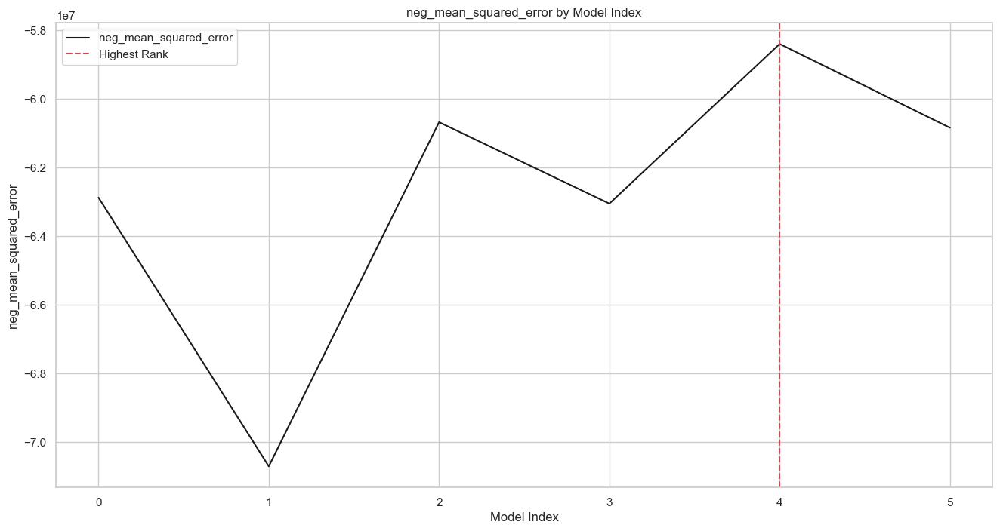

,param_selector__n_features_to_select,param_transform__poly__degree,params,mean_test_score,std_test_score,rank_test_score,total_proc_time
0,6,1,"{'selector__n_features_to_select': 6, 'transform__poly__degree': 1}",-62872929.119179,14789086.903548,4,20.397303
1,6,2,"{'selector__n_features_to_select': 6, 'transform__poly__degree': 2}",-70709587.619589,17034424.620303,6,22.477088
2,7,1,"{'selector__n_features_to_select': 7, 'transform__poly__degree': 1}",-60673741.340439,13950921.030821,2,26.267418
3,7,2,"{'selector__n_features_to_select': 7, 'transform__poly__degree': 2}",-63048982.355721,14739068.404273,5,27.260164
4,8,1,"{'selector__n_features_to_select': 8, 'transform__poly__degree': 1}",-58392941.747532,13540884.826878,1,31.289260
5,8,2,"{'selector__n_features_to_select': 8, 'transform__poly__degree': 2}",-60836141.970350,13909392.994695,3,34.388229


CPU times: user 4h 31min 29s, sys: 55min 29s, total: 5h 26min 58s
Wall time: 39min 20s


In [457]:
%%time
grid_jse_sfs_lr = hyperparameter_search(
    X, y,
    transformer=poly_ord_ohe_jse, 
    selector = SequentialFeatureSelector(estimator=LinearRegression()), 
    scaler=StandardScaler(),
    regressor=TransformedTargetRegressor(regressor=LinearRegression(),
                                             func=np.log1p,
                                             inverse_func=np.expm1 ),
    ttr=True,
    transformer_params={'transform__poly__degree': [1,2]},  
    selector_params={'selector__n_features_to_select': [6,7,8]},
    regressor_params={}, 
    scoring= ["neg_mean_squared_error"],
    kfolds=[5, 10], 
    verbose=1
)

### Findings after Grid Searches 1:  

- The model selected had Polynomial Degree = 1 and Features Selected = 8
- We do note that another model with Degree = 1 and Features Selected = 7 performed almost just as well and may be less overfit
- kfold = 10 performed better twice so in the interest of time we will limit future grid searches to cv=10

### GridSearch2:  Use Lasso selector to see if it can do better than SFS all other things being equal
- StandardScaler
- Lasso SelectFromModel Selector
- TransformedTargetRegressor (func=np.log1p) with LinearRegression
- For optimizing time we will use K folds as 5 itself

Fitting 5 folds for each of 2 candidates, totalling 10 fits


Scoring Method: neg_mean_squared_error
Best k value= 5 (K-fold CV)
Best HyperParameters: {'transform__poly__degree': 1}
Refit Time: 12.0906s
Best Model Details: Pipeline(steps=[('transform',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('poly',
                                                  PolynomialFeatures(degree=1,
                                                                     include_bias=False),
                                                  ['year', 'odometer']),
                                                 ('ohe',
                                                  OneHotEncoder(drop='if_binary',
                                                                sparse_output=False),
                                                  ['fuel', 'title_status',
                                                   'transmission', 'type',
            

feature,poly__year,poly__odometer,ohe__fuel_diesel,ohe__fuel_electric,ohe__fuel_hybrid,ohe__fuel_other,ohe__title_status_clean,ohe__title_status_lien,ohe__title_status_missing,ohe__title_status_parts only,ohe__title_status_rebuilt,ohe__transmission_manual,ohe__transmission_other,ohe__type_SUV,ohe__type_bus,ohe__type_convertible,ohe__type_coupe,ohe__type_hatchback,ohe__type_offroad,ohe__type_other,ohe__type_pickup,ohe__type_sedan,ohe__type_truck,ohe__type_van,ohe__type_wagon,ohe__paint_color_blue,ohe__paint_color_brown,ohe__paint_color_custom,ohe__paint_color_green,ohe__paint_color_grey,ohe__paint_color_orange,ohe__paint_color_purple,ohe__paint_color_red,ohe__paint_color_silver,ohe__paint_color_white,ohe__paint_color_yellow,jse__manufacturer,jse__model,remainder__cylinders_labenc,remainder__condition_labenc,remainder__drive_labenc
coef,0.32109,-0.18331,0.080332,-0.005328,0.010921,-0.015794,0.047993,0.0237,-0.025675,-0.017369,0.012633,0.017828,0.010564,0.036982,0.009106,0.045989,0.02132,-0.006891,0.021271,0.025364,0.091203,-0.019556,0.076348,0.022613,0.014274,-0.011296,-0.005919,0.010998,-0.004286,-0.006696,-0.006766,-0.00112,-0.007238,-0.008139,0.001203,0.004106,0.033079,0.23566,0.08155,0.094686,0.04146


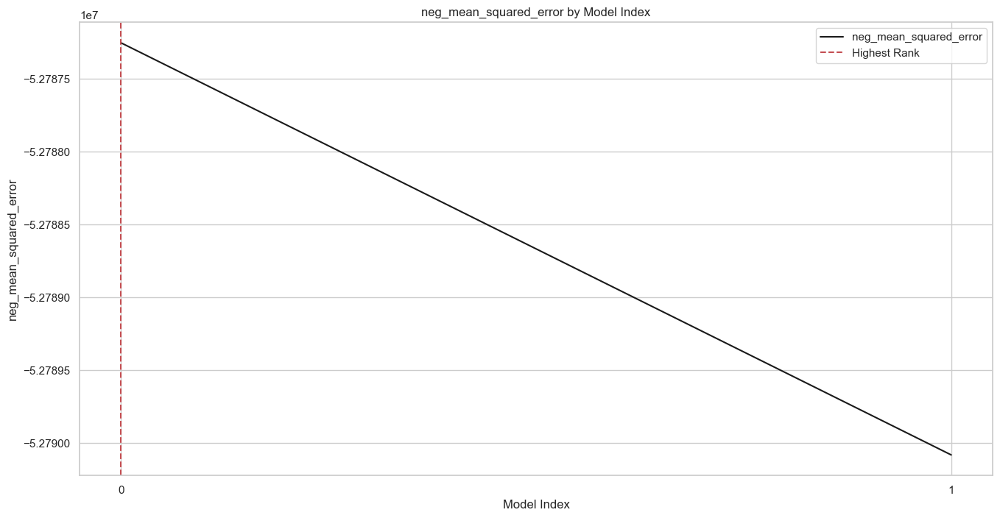

,param_transform__poly__degree,params,mean_test_score,std_test_score,rank_test_score,total_proc_time
0,1,{'transform__poly__degree': 1},-52787254.044356,8372107.053547,1,17.696149
1,2,{'transform__poly__degree': 2},-52790080.747786,8651805.434633,2,17.603603


CPU times: user 25min 40s, sys: 59.4 s, total: 26min 39s
Wall time: 3min 2s


In [461]:
%%time
grid_jse_lasso_lr = hyperparameter_search(
    X, y,
    transformer=poly_ord_ohe_jse, 
    selector = SelectFromModel(Lasso()), 
    scaler=StandardScaler(),
    regressor=TransformedTargetRegressor(regressor=LinearRegression(),
                                             func=np.log1p,
                                             inverse_func=np.expm1 ),
    ttr=True,
    transformer_params={'transform__poly__degree': [1,2]},  
    selector_params={},
    regressor_params={}, 
    scoring= ["neg_mean_squared_error"],
    kfolds=[5], 
    verbose=1
)

### Findings after Grid Searches 2:  

- The Grid search 2 with LASSO SelectFromModel selector shows best model with Polynomial Degree = 1 and Features Selected = 8
- The MSE of this LASSO model is better than SFS model
- kfold = 5 performed much faster and still better with this model than 10 with  with much less processing time

### Evaluation

With some modeling accomplished, we aim to reflect on what we identify as a high quality model and what we are able to learn from this.  We should review our business objective and explore how well we can provide meaningful insight on drivers of used car prices.  Your goal now is to distill your findings and determine whether the earlier phases need revisitation and adjustment or if you have information of value to bring back to your client.

### Score of our 2 best models
Now that we have run our Grid Searches, we will look at the score of our **best 2 models** since the results were close. We willl also do holdout validation for our 2 best models

In [478]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3 ,random_state = 42)

In [476]:
print(f"grid_jse_sfs_lr best model score against the train set is: {grid_jse_sfs_lr['best_model'].score(X_train, y_train):.2f}")
print(f"grid_jse_sfs_lr best model score against the test set is: {grid_jse_sfs_lr['best_model'].score(X_test, y_test):.2f}")

grid_jse_sfs_lr best model score against the train set is: 0.51
grid_jse_sfs_lr best model score against the test set is: 0.49


In [479]:
print(f"grid_jse_lasso_lr best model score against the train set is: {grid_jse_lasso_lr['best_model'].score(X_train, y_train):.2f}")
print(f"grid_jse_lasso_lr best model score against the test set is: {grid_jse_lasso_lr['best_model'].score(X_test, y_test):.2f}")

grid_jse_lasso_lr best model score against the train set is: 0.56
grid_jse_lasso_lr best model score against the test set is: 0.59


#### Model Selection:  We select Lasso Selector with TransformedTargetRegressor with 8 features
- The score of this LASSO selector with TransformedTargetRegressor with 1 Polynomial and 8 features is performing good
- We also note the model does not seem overfit

In [473]:
#### Holdout Validation with Model 2 - Lasso Selector with TransformedTargetRegressor with 8 features
model = grid_jse_sfs_lr['best_model']
#Shuffle and split the data
X_train, X_test, y_train, y_test = train_test_split(X, np.log1p(y), test_size = 0.3 ,random_state = random_state)

#Fit model
model.fit(X_train, y_train)

#predict and compute train and test MSEs
train_preds_lr = model.predict(X_train)
test_preds_lr = model.predict(X_test)
train_mse_lr = mean_squared_error(y_train, train_preds_lr)
test_mse_lr = mean_squared_error(y_test, test_preds_lr)

print(f'TransformedTargetRegressor with 8 features Train MSE: {train_mse_lr: .2f}')
print(f'TransformedTargetRegressor with 8 features Train MSE: {test_mse_lr: .2f}')

TransformedTargetRegressor with 8 features Train MSE:  0.44
TransformedTargetRegressor with 8 features Train MSE:  0.45


#### Permutation Importance
Below we examine the importance rank of the features for our specific model.  We note that for most score types the rank for feature importance was year, odometer, model, cylinders , fuel, type, condition and finally drive

In [467]:
feature_names = X_train.columns
feature_names.values

array(['year', 'manufacturer', 'model', 'fuel', 'odometer',
       'title_status', 'transmission', 'type', 'paint_color',
       'cylinders_labenc', 'condition_labenc', 'drive_labenc'],
      dtype=object)

In [474]:
model = grid_jse_sfs_lr['best_model']
scoring = ['r2', 'neg_mean_absolute_percentage_error', 'neg_mean_squared_error', 'explained_variance']
r_multi = permutation_importance(model, X_test, y_test, n_repeats=30, random_state=42, scoring=scoring)
#print(r_multi)
for metric in r_multi:
    print(f"{metric}")
    r = r_multi[metric]
    for i in r.importances_mean.argsort()[::-1]:
        if r.importances_mean[i] - 2 * r.importances_std[i] > 0:
            print(f"    {feature_names.values[i]:<8}      "
                  f"{r.importances_mean[i]:.3f}"
                  f" +/- {r.importances_std[i]:.3f}")

r2
    year          0.286 +/- 0.003
    odometer      0.097 +/- 0.002
    model         0.050 +/- 0.001
    cylinders_labenc      0.044 +/- 0.001
    fuel          0.033 +/- 0.001
    type          0.022 +/- 0.001
    condition_labenc      0.022 +/- 0.001
    drive_labenc      0.017 +/- 0.001
neg_mean_absolute_percentage_error
    year          0.022 +/- 0.000
    odometer      0.010 +/- 0.000
    model         0.005 +/- 0.000
    cylinders_labenc      0.003 +/- 0.000
    fuel          0.002 +/- 0.000
    condition_labenc      0.002 +/- 0.000
    type          0.002 +/- 0.000
    drive_labenc      0.002 +/- 0.000
neg_mean_squared_error
    year          0.252 +/- 0.002
    odometer      0.086 +/- 0.001
    model         0.044 +/- 0.001
    cylinders_labenc      0.039 +/- 0.001
    fuel          0.029 +/- 0.001
    type          0.019 +/- 0.001
    condition_labenc      0.019 +/- 0.001
    drive_labenc      0.015 +/- 0.001
explained_variance
    year          0.285 +/- 0.003
    odomet

### Coefficient Interpretattion

In [483]:
#Get transformed and selected feature names
ohe_feature_names = model.named_steps['transform'].get_feature_names_out()
selected_mask = model.named_steps['selector'].get_support()
transformed_simplified_feature_names = np.array(ohe_feature_names)[selected_mask]
transformed_simplified_feature_names

#Get coefficients and intercept 
simplified_coefs = model.named_steps['regressor'].regressor_.coef_
simplified_intercept = model.named_steps['regressor'].regressor_.intercept_

#Create dataframe for coefficients
simplified_coefs_df = pd.DataFrame({'features': transformed_simplified_feature_names, 'coefs': simplified_coefs})

#Convert the coefficients using expm1 to reflect the change in the original price
simplified_coefs_df['coefs_exponential'] = np.expm1(simplified_coefs_df['coefs'])


print(f'The intercept of the model is: {simplified_intercept: .2f} and the coefficients and their exponentials are shown below.')

# Display the transformed coefficients using expm1
simplified_coefs_df

The intercept of the model is:  2.32 and the coefficients and their exponentials are shown below.


,features,coefs,coefs_exponential
0,poly__year,0.034467,0.035068
1,poly__odometer,-0.019559,-0.019369
2,ohe__fuel_diesel,0.011454,0.011520
3,ohe__type_sedan,-0.009535,-0.009490
4,jse__model,0.016554,0.016692
5,remainder__cylinders_labenc,0.013449,0.013540
6,remainder__condition_labenc,0.009729,0.009776
7,remainder__drive_labenc,0.008303,0.008338


In [ ]:
# Calculate the correlation matrix
correlation_matrix = df_prepared.corr()

# Define the threshold for significant correlation
threshold = 0.1

# Filter the columns that have a significant correlation with 'price'
significant_corr_columns = correlation_matrix[correlation_matrix['price'] > threshold]['price'].index

# Obtain the significant correlations
significant_corr_matrix = correlation_matrix.loc[significant_corr_columns, significant_corr_columns]

# Create a heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(significant_corr_matrix, annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Heatmap of Significant Correlations")
plt.show()

#### Residual Analysis
Note that the gridsearch results were used in this case because the predictions are not in the log scale

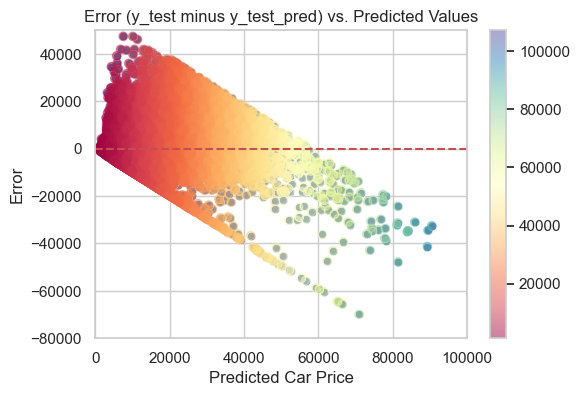

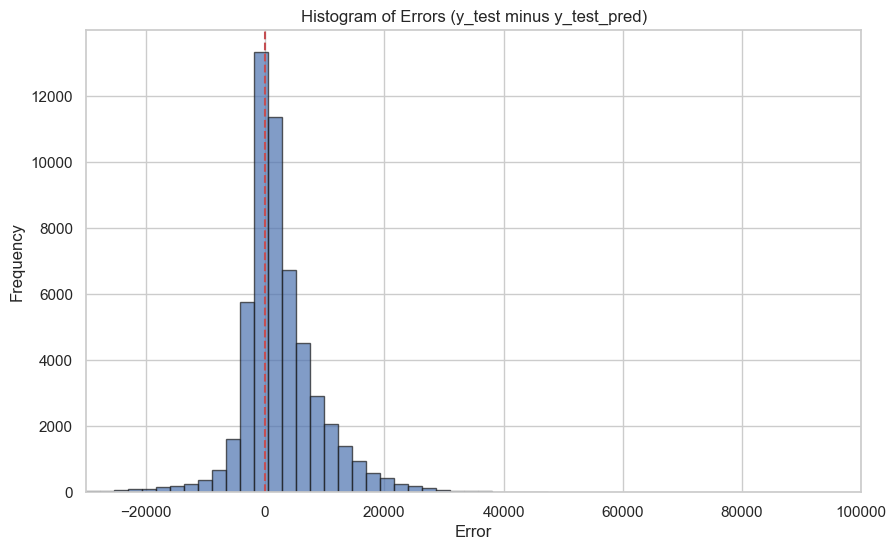

In [568]:
#Residual Analysis
## convert the predicted value from log1p to regular using np.expm1
y_pred = np.expm1(model.predict(X_test))
residuals = y_test - y_pred
plt.figure(figsize=(6,4))
sns.scatterplot(x=y_pred, y=residuals)
plt.scatter(y_pred, residuals, alpha=0.5, c=y_pred, cmap='Spectral')
plt.colorbar()
#plt.xticks(range(len(y_pred)))
plt.axhline(y=0, color='r', linestyle='--')
plt.title('Error (y_test minus y_test_pred) vs. Predicted Values')
plt.xlim(0, 100000)
plt.ylim(-80000,50000)
plt.xlabel('Predicted Car Price')
plt.ylabel('Error')
plt.grid(True)
plt.savefig('images/residual_prediction_plot.png')
plt.show()

# Plotting histogram of residuals
plt.figure(figsize=(10,6))
plt.hist(residuals, bins=50, edgecolor='k', alpha=0.7)
plt.axvline(x=0, color='r', linestyle='--')
plt.title('Histogram of Errors (y_test minus y_test_pred)')
plt.xlim(-30000,100000)
plt.xlabel('Error')
plt.ylabel('Frequency')
plt.grid(True)
plt.savefig('images/residual_prediction_histogram.png')
plt.show()

In [496]:
%pip install -U numpy

Note: you may need to restart the kernel to use updated packages.


In [522]:
print("My numpy version is: ", np.__version__)

My numpy version is:  1.23.5


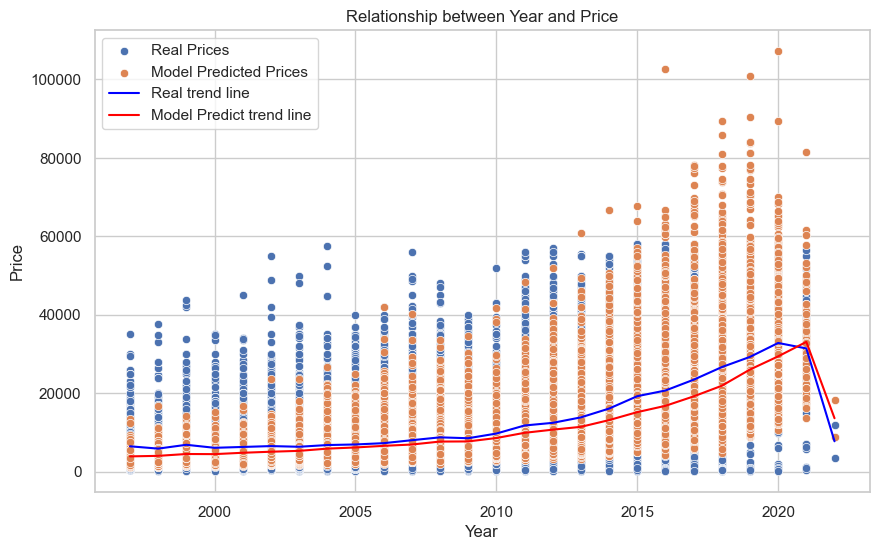

<Figure size 640x480 with 0 Axes>

In [567]:
# Visualize the relationship between LASSO Model and Real Price with Test data and a Year vs Price Plot
plot_test_pred = X_test.copy()
plot_test_real = X_test.copy()
## convert the predicted value from log1p to regular using np.expm1
plot_test_pred['price_pred'] = np.expm1(model.predict(X_test))
plot_test_real['price_real'] = y_test

plt.figure(figsize=(10, 6))
sns.scatterplot(x='year', y='price_real', data=plot_test_real, label='Real Prices')
sns.scatterplot(x='year', y='price_pred', data=plot_test_pred, label='Model Predicted Prices')
#Bypass bug with numpy & seaborn version https://github.com/mwaskom/seaborn/issues/3192
try :
    sns.lineplot(x='year', y='price_real', data=plot_test_real, color='blue', label='Real trend line')
except TypeError:
    pass
try :
    sns.lineplot(x='year', y='price_pred', data=plot_test_pred, color='red', label='Model Predict trend line')
except TypeError:
    pass
plt.title('Relationship between Year and Price')
plt.xlabel('Year')
plt.ylabel('Price')
plt.legend()
plt.show()
plt.savefig('images/model_prediction.png')


### Deployment

Now that we've settled on our models and findings, it is time to deliver the information to the client.  You should organize your work as a basic report that details your primary findings.  Keep in mind that your audience is a group of used car dealers interested in fine tuning their inventory.

## Summary Report to dealers

## Findings from Data Exploration -

1. The initial raw data contained lot of missing values for model, type, paint_color, cylinder, drive and condition
2. Few data that could be fixed were attempted to be fixed
3. Analysis was not performed based on region or state as location was not found to be key feature 
4. Final data set after cleanup was only 40% of original data provided


## Observations & Recommendations

- Most single important feature that affects car price is manufactured Year. This alone contributes to over 25% to car price
- Other features that drives the car price in below order -
  - Odometer: 10%
  - model: 5%
  - cylinders: 4%
  - fuel: 3%
  - type: 1% 
  - condition: 1% 
  - drive: 1%
- More cylinder cars leads to higher prices
- Include Diesel cars in inventory
- All Wheel drive cars holds more value and priced higher

In [ ]:
### Available prediction model
- Current model has a prediction scoring of 60% accuracy
- Prediction improves as car price goes up and pricing error is reduced

### Next Steps
 - Reduce usage of categories of 'other' or 'missing' by reclassifying them properly when possible
 - Correct bad data such as zero USD pricing or odometer readings in the billions
 - Rerun models of higher ranks
 - Attempt other type of models
 - Clearly note the rank of drive trains, number of cylinders and fuel types for their impact on price 
 - Include location data to explore how pricing vary based on state or city etc
 - Update this document as new findings are made